### **Introduction**

This notebook contains Singtel stock market share price prediction using Long short-term memory(LSTM) model to estimate the future prices of stocks, where will be using 10 years of Singtel's stock price data.

### Stock Market Share Price Prediction


#### Connecting Google Drive

First step is to connect the notebook with Google drive to retrieve the data required for the share price prediction. You can either upload the dataset into the workspace. But do remember that, workspace will be cleaned after session is expired. Hence best approach is to manage datasets in either Google Drive, FTP location, database or any storage account.

In [ ]:
# Libraries required to connect to Google Drive to retrieve the data file
# !pip install -U -q PyDrive
# from pydrive.auth import GoogleAuth
# from pydrive.drive import GoogleDrive
# from google.colab import auth
# from oauth2client.client import GoogleCredentials
# auth.authenticate_user()
# gauth = GoogleAuth()
# gauth.credentials = GoogleCredentials.get_application_default()
# drive = GoogleDrive(gauth)

When prompted, click on the link to get authentication to allow Google to access your Drive. You should see a screen with “Google Cloud SDK wants to access your Google Account” at the top. After you allow permission, copy the given verification code and paste it in the box in Colab.

### Load the dataset

In [1]:
# This is the file ID of the data set
dataset_file_id = '1IjIPoFAASILDoVzuN479Kia4-0rrDvLM'

# Download the file from Google Drive
# downloaded = drive.CreateFile({'id':dataset_file_id}) 
# downloaded.GetContentFile('singtel.csv')

### Setting up the environment

Writing less amount of code and utilize existing libraries to assist with the prediction task is the recommended approach on solving data science problems. There is large number of open source python libraries available to assist with solving problems without worrying underline technical complexities on building them from the scratch.

In [2]:
# Time series decomposition
!pip install stldecompose

# Shap explainability
!pip install shap

!pip install pandas-datareader
!pip install yfinance
!pip install fastapi
!pip install colabcode

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


#### Importing python packages

Importing necessary packages from available python libraries is the next step towards building the predictive model. 

In [3]:
import os

# Data processing libraries
import numpy as np
import pandas as pd

# Predive modeling related libraries
import xgboost as xgb
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split, GridSearchCV
import lightgbm as lgb

#Model explainability
import shap
from xgboost import plot_tree
from lightgbm import plot_importance

# Data visualization related package imports
import matplotlib.pyplot as plt
import plotly as py
import plotly.io as pio
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from IPython.display import HTML

# Disable sklearn warnings
from warnings import simplefilter
simplefilter(action='ignore', category=FutureWarning)
simplefilter(action='ignore', category=DeprecationWarning)

# Accuracy evaluaters
import sklearn.metrics as sm

from statsmodels.tsa.seasonal import STL
# from stldecompose import decompose

# Show charts when running kernel
init_notebook_mode(connected=True)

# Change default background color for all visualizations
layout=go.Layout(paper_bgcolor='rgba(0,0,0,0)', plot_bgcolor='rgba(250,250,250,0.8)')
fig = go.Figure(layout=layout)
templated_fig = pio.to_templated(fig)
pio.templates['my_template'] = templated_fig.layout.template
pio.templates.default = 'my_template'

import yfinance as yf
from pandas_datareader import data as pdr
from pydantic import BaseModel
from fastapi import FastAPI
import pickle

### Data Visualization





####Retrieving Stock Information

We are using yfinance python package to retrieve the stock market information of Singtel stock price. It offers many information about the company and the stock price which is useful to build stock market prediction applications.

In [4]:
singtel = yf.Ticker("Z74.SI")

# get stock info
singtel.info

{'zip': '239732',
 'sector': 'Communication Services',
 'fullTimeEmployees': 22543,
 'longBusinessSummary': 'Singapore Telecommunications Limited, together with its subsidiaries, provides telecommunication services to consumers and small businesses in Singapore, Australia, the United States, Europe, and internationally. The company engages in the carriage business, including mobile, pay television, fixed broadband, voice, and content and digital services, as well as equipment sales; digital media and advertising services; integrated information and communications technology solutions, such as cloud computing, multi-access edge computing, software-defined network, and digital solutions; fund management services to enterprise customers. It also offers mobile phones, accessories, watches, watch straps, cables, adapters, multimedia hubs, cameras, gimbals, cases, chargers, drones, earphones, headphones, microphones, keyboards, laptops, screen protectors, speakers, tablets, trackers, and wea

In [5]:
# show major share holder information
singtel.major_holders

,0,1
0,5.96%,% of Shares Held by All Insider
1,65.37%,% of Shares Held by Institutions
2,69.51%,% of Float Held by Institutions
3,388,Number of Institutions Holding Shares


Visualizing the data is an important aspect of solving data science problem which provides insights into the data distributions and identify patterns. We are using yfinance python package to retrieve the data for the specific period of time.

In [6]:
# df = pd.read_csv('singtel.csv', sep=',')
# df = pdr.get_data_yahoo("Z74.SI", start="2010-01-01", end="2018-12-31")
df = yf.download("Z74.SI", start="2010-01-01", end="2018-12-31")
df['Date'] = df.index
df['Date'] = pd.to_datetime(df['Date'])
df.index = range(len(df))

df.head()

[*********************100%***********************]  1 of 1 completed


,Open,High,Low,Close,Adj Close,Volume,Date
0,3.11,3.13,3.09,3.13,1.755209,11659000,2010-01-04
1,3.16,3.16,3.08,3.12,1.749602,25150000,2010-01-05
2,3.11,3.14,3.09,3.10,1.738386,13382000,2010-01-06
3,3.10,3.11,3.01,3.03,1.699132,26989000,2010-01-07
4,3.04,3.05,3.01,3.05,1.710348,17903000,2010-01-08


In [7]:
# Fill empty values with forward fill
df.ffill(axis = 0, inplace=True)
df.head()

,Open,High,Low,Close,Adj Close,Volume,Date
0,3.11,3.13,3.09,3.13,1.755209,11659000,2010-01-04
1,3.16,3.16,3.08,3.12,1.749602,25150000,2010-01-05
2,3.11,3.14,3.09,3.10,1.738386,13382000,2010-01-06
3,3.10,3.11,3.01,3.03,1.699132,26989000,2010-01-07
4,3.04,3.05,3.01,3.05,1.710348,17903000,2010-01-08


#### OHLC (open/high\/low\/close) Chart

OHLC chart visualize how share price traded each day with open, high ,low and close values. This chart provide overview on how momentum or volatility of stock changed over the time. Sample points where the close value is higher than the open value are drawn in green whereas decreasing are drawn in red.

In [8]:
fig = make_subplots(rows=2, cols=1)

fig.add_trace(go.Ohlc(x=df.Date,
                      open=df.Open,
                      high=df.High,
                      low=df.Low,
                      close=df.Close,
                      name='Price'), row=1, col=1)

fig.add_trace(go.Scatter(x=df.Date, y=df.Volume, name='Volume'), row=2, col=1)

HTML(fig.to_html())

#### Volume Chart

Volume of share price data indicates the daily number of shares traded over a selected period. Volume is very important component because it provide how volume impact on the stock price.

In [9]:
fig = go.Figure(go.Bar(x=df.Date, y=df.Volume, name='Volume', marker_color='red'))
HTML(fig.to_html())

#### Time Series Decomposition

Stock market price predication contains time series data which shows the price variation over the time. Time series data can be decomposed into Trend, Seasonal and Noise components which can be use as features. Combining these components will align with the final stock price variation. 

$y(t) = Trend + Seasonality + Noise$

Decomposition provides insights of the time series data on how these components can be best captured in a given model. It's very important to focus on decomposed components at data preparation, model selection, and model tuning. Here we are showing how it can be achieved with existing python library.


Please refer this [article](https://www.statsmodels.org/stable/generated/statsmodels.tsa.seasonal.STL.html) for more information.

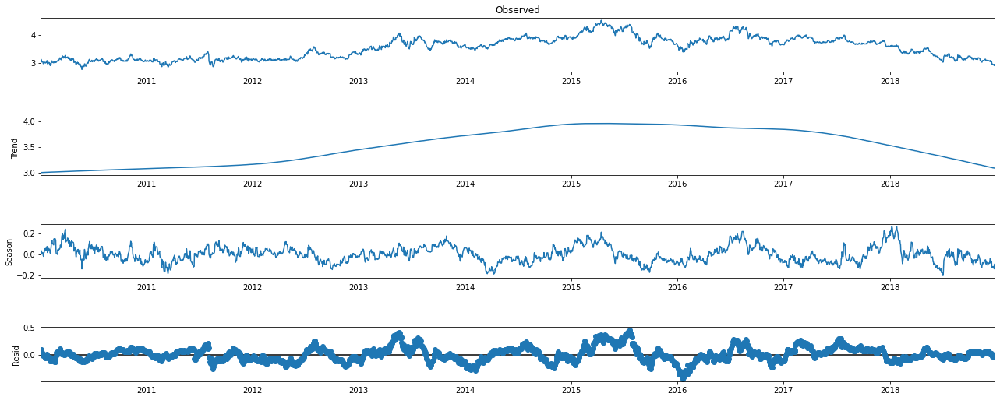

In [10]:
df_close = df[['Date', 'Close']].copy()
df_close = df_close.set_index('Date')
df_close.head()

ts_decomposed = STL(df_close, period=365).fit()
fig = ts_decomposed.plot()
fig.set_size_inches(20, 8)
plt.show()

### Data Preprocessing

Data pre-processing is an important phase of solving data science problem which targeted on preparing the data to build the prediction models. 

Outliers which known as noisy or out of range values should be replaced or removed. Here, we are replacing outliers with the average.

In [11]:
#Average of the volume excluding outliers
mean = df.loc[df['Volume'] < 100000000, 'Volume'].mean()

#Replace the outliers with mean value
df.loc[df.Volume > 100000000, 'Volume'] = np.nan
df.fillna(mean, inplace=True)

fig = go.Figure(go.Bar(x=df.Date, y=df.Volume, name='Volume', marker_color='red'))
HTML(fig.to_html())

### Feature Engineering

Feature engineering is associate with working on features which are relevant for the target prediction. We are predicting the closing stock price of the given dataset. Hence, it's very important to identify and derive necessary features required for the stock price prediction task. As stated, above, technical indicators are very important in predicting the stock price. These technical indicators are derived from the existing data which will be added as new features.

There are lot of important characteristics of the stock price such as trend or momentum help you to predict future prices. These technical indicators useful in improving the accuracy of the prediction.


##### Moving Averages

Moving averages of the closing stock price is useful in predicting the future stock prices as it indicate how stock priced varied within selected time interval eg 5 last 5, 10, 15 and 30 days. As daily stock price over the time can be fluctuated rapidly, moving averages help to smooth out stock prices on a chart by filtering out short-term price fluctuations. There are two (most common) averages used in technical analysis which are:

Simple Moving Average (SMA) - a simple average calculated over last N days e.g. 50, 100 or 200,
Exponential Moving Average (EMA) - an average where greater weights are applied to recent prices. We are deriving new features based on moving averages and name them  as $SMA_{5}$, $SMA_{10}$, $SMA_{15}$, $SMA_{30}$ and $EMA_{9}$.

Plotting these features shows how they have helped to smooth out the noisy curves.

In [12]:
df['EMA_9'] = df['Close'].ewm(9).mean().shift()
df['SMA_5'] = df['Close'].rolling(5).mean().shift()
df['SMA_10'] = df['Close'].rolling(10).mean().shift()
df['SMA_15'] = df['Close'].rolling(15).mean().shift()
df['SMA_30'] = df['Close'].rolling(30).mean().shift()

fig = go.Figure()
fig.add_trace(go.Scatter(x=df.Date, y=df.EMA_9, name='EMA 9'))
fig.add_trace(go.Scatter(x=df.Date, y=df.SMA_5, name='SMA 5'))
fig.add_trace(go.Scatter(x=df.Date, y=df.SMA_10, name='SMA 10'))
fig.add_trace(go.Scatter(x=df.Date, y=df.SMA_15, name='SMA 15'))
fig.add_trace(go.Scatter(x=df.Date, y=df.SMA_30, name='SMA 30'))
fig.add_trace(go.Scatter(x=df.Date, y=df.Close, name='Close', opacity=0.2))
HTML(fig.to_html())

#### Relative Strength Index

Relative Strength Index (RSI) is another important indicator to predict stock price where it indicates the magnitude of recent price changes. It provides insights on whether a stock is either overbought or oversold. Typically RSI range from 0 to 100 and value greater or equal than 70 signal that a stock is becoming overbought/overvalued, meanwhile value less than or equal 30 indicate that it is oversold. Full range of RSI is from 0 to 100.

We have added RSI as feature to predict the stock price.

In [13]:
def relative_strength_idx(df, n=14):
    close = df['Close']
    delta = close.diff()
    delta = delta[1:]
    pricesUp = delta.copy()
    pricesDown = delta.copy()
    pricesUp[pricesUp < 0] = 0
    pricesDown[pricesDown > 0] = 0
    rollUp = pricesUp.rolling(n).mean()
    rollDown = pricesDown.abs().rolling(n).mean()
    rs = rollUp / rollDown
    rsi = 100.0 - (100.0 / (1.0 + rs))
    return rsi

df['RSI'] = relative_strength_idx(df).fillna(0)

fig = go.Figure(go.Scatter(x=df.Date, y=df.RSI, name='RSI'))
HTML(fig.to_html())

#### Moving Average Convergence Divergence (MACD) 

MACD is an indicator which shows the relationship between two exponential moving averages i.e. 12-day and 26-day EMAs. This is very important feature in share price prediction. We have obtain MACD by subtracting 26-day EMA (known as slow EMA) from the 12-day EMA (known as fast EMA).

More information can be found in this [article](https://www.investopedia.com/terms/m/macd.asp).

In [14]:
EMA_12 = pd.Series(df['Close'].ewm(span=12, min_periods=12).mean())
EMA_26 = pd.Series(df['Close'].ewm(span=26, min_periods=26).mean())
df['MACD'] = pd.Series(EMA_12 - EMA_26)
df['MACD_signal'] = pd.Series(df.MACD.ewm(span=9, min_periods=9).mean())

fig = make_subplots(rows=2, cols=1)
fig.add_trace(go.Scatter(x=df.Date, y=df.Close, name='Close'), row=1, col=1)
fig.add_trace(go.Scatter(x=df.Date, y=EMA_12, name='EMA 12'), row=1, col=1)
fig.add_trace(go.Scatter(x=df.Date, y=EMA_26, name='EMA 26'), row=1, col=1)
fig.add_trace(go.Scatter(x=df.Date, y=df['MACD'], name='MACD'), row=2, col=1)
fig.add_trace(go.Scatter(x=df.Date, y=df['MACD_signal'], name='Signal line'), row=2, col=1)
HTML(fig.to_html())

### Preparing data for prediction

We are predicting the next day stock market price. Predicting share price for very large periods often not very accurate as it can subject into various factors. Hence we are shifting the closing stock market price by 1 which replace current value with the next day share price value.

In [15]:
df['Close'] = df['Close'].shift(-1)

In [16]:
df[:35]

,Open,High,Low,Close,Adj Close,Volume,Date,EMA_9,SMA_5,SMA_10,SMA_15,SMA_30,RSI,MACD,MACD_signal
0,3.11,3.13,3.09,3.12,1.755209,11659000.0,2010-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3.16,3.16,3.08,3.10,1.749602,25150000.0,2010-01-05,3.130000,NaN,NaN,NaN,NaN,0.000000,NaN,NaN
2,3.11,3.14,3.09,3.03,1.738386,13382000.0,2010-01-06,3.124737,NaN,NaN,NaN,NaN,0.000000,NaN,NaN
3,3.10,3.11,3.01,3.05,1.699132,26989000.0,2010-01-07,3.115609,NaN,NaN,NaN,NaN,0.000000,NaN,NaN
4,3.04,3.05,3.01,3.02,1.710348,17903000.0,2010-01-08,3.090715,NaN,NaN,NaN,NaN,0.000000,NaN,NaN
5,3.06,3.06,3.02,2.97,1.693525,21861000.0,2010-01-11,3.080773,3.086,NaN,NaN,NaN,0.000000,NaN,NaN
6,3.02,3.03,2.97,2.97,1.665486,42581000.0,2010-01-12,3.067803,3.064,NaN,NaN,NaN,0.000000,NaN,NaN
7,2.96,2.98,2.95,3.02,1.665486,19207000.0,2010-01-13,3.049056,3.034,NaN,NaN,NaN,0.000000,NaN,NaN
8,2.98,3.06,2.98,3.01,1.693525,24858000.0,2010-01-14,3.035175,3.008,NaN,NaN,NaN,0.000000,NaN,NaN
9,3.04,3.05,3.01,3.02,1.687917,10979000.0,2010-01-15,3.032698,3.006,NaN,NaN,NaN,0.000000,NaN,NaN


#### Drop invalid samples

MACD_signal feature is calculated based on SMA12 and SMA12 features with span of 9. Hense we have filtered out the first 33 rows where the MACD_signal feature is empty.

In [17]:
df = df.iloc[33:] # Because of moving averages and MACD line
df = df[:-1]      # Because of shifting close price

df.index = range(len(df))

#### Select Train, Validation and Test datasets

 In any prediction problem, it's very important to have Train, Validation and Test datasets. Training dataset used to train the model while validation dataset used to test the accuracy of the model. Test dataset is used to evaluate the accuracy of the final model.

In time series data, selecting these three splits can't be done in random order. It has to follow time divided approach as shown in the below figure.
Here we have split stock data frame into three subsets: training set consists of ($70\%$) data, validation set consist of ($15\%$) data and test set consists of ($15\%$) data. These splits are assigned to three data frames named train_df, valid_df, test_df. All three frames have been plotted in the figure below.


In [18]:
test_size  = 0.15
valid_size = 0.15

test_split_idx  = int(df.shape[0] * (1-test_size))
valid_split_idx = int(df.shape[0] * (1-(valid_size+test_size)))

train_df  = df.loc[:valid_split_idx].copy()
valid_df  = df.loc[valid_split_idx+1:test_split_idx].copy()
test_df   = df.loc[test_split_idx+1:].copy()

fig = go.Figure()
fig.add_trace(go.Scatter(x=train_df.Date, y=train_df.Close, name='Training'))
fig.add_trace(go.Scatter(x=valid_df.Date, y=valid_df.Close, name='Validation'))
fig.add_trace(go.Scatter(x=test_df.Date,  y=test_df.Close,  name='Test'))
HTML(fig.to_html())

#### Clean Data Columns

Earlier, we have derived new features to predict the closing stock price. Hence below features aren't use to predict the closing price. Hence we have dropped below columns. 

In [19]:
drop_cols = ['Date', 'Volume', 'Open', 'Low', 'High', 'Adj Close']

train_df = train_df.drop(drop_cols, 1)
valid_df = valid_df.drop(drop_cols, 1)
test_df  = test_df.drop(drop_cols, 1)

#### Perparing Data for Prediction

Below step separate the closing stock price and the rest of the features into data frames. It's a common step for any predictive modelling problem. As you can see features named EMA_9, SMA_5, SMA_10, SMA_15, SMA_30, RSI, MACD and MACD_signal used to predict the closing share price.

In [20]:
y_train = train_df['Close'].copy()
X_train = train_df.drop(['Close'], 1)

y_valid = valid_df['Close'].copy()
X_valid = valid_df.drop(['Close'], 1)

y_test  = test_df['Close'].copy()
X_test  = test_df.drop(['Close'], 1)

X_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1556 entries, 0 to 1555
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   EMA_9        1556 non-null   float64
 1   SMA_5        1556 non-null   float64
 2   SMA_10       1556 non-null   float64
 3   SMA_15       1556 non-null   float64
 4   SMA_30       1556 non-null   float64
 5   RSI          1556 non-null   float64
 6   MACD         1556 non-null   float64
 7   MACD_signal  1556 non-null   float64
dtypes: float64(8)
memory usage: 97.4 KB


### Predicting with XGBoost

XGBoost is one of most successfully applied machine learning algorithm which introduced in recent times. It dominated many traditional machine learning algorithms with superior accuracy and performances. XGBoost algorithm is an implementation of gradient boosting decision trees. Many organizations now utilize XGBoost in their predictive modelling applications to achieve better performances.

More information on the algorithm can be found in [article 1](https://machinelearningmastery.com/gentle-introduction-xgboost-applied-machine-learning/) and [article 2](https://towardsdatascience.com/https-medium-com-vishalmorde-xgboost-algorithm-long-she-may-rein-edd9f99be63d)

In [21]:
model_xgb = xgb.XGBRegressor(n_estimators=120, learning_rate=0.01, max_depth=12, gamma=0.02, objective='reg:squarederror')
model_xgb.fit(X_train, y_train)

XGBRegressor(gamma=0.02, learning_rate=0.01, max_depth=12, n_estimators=120,
             objective='reg:squarederror')

### Predicting with LightGBM

LightGBM which stand for Light Gradient Boosting Machine is another recent machine learning algorithm which targeted on achieving improved accuracy with low computational resources. LightGBM is originated from Microsoft and known for capabilities on faster training speeds, low memory utilization, parallel learning and handling large amount of data.

More information on the algorithm can be found in [article 1](https://medium.com/@pushkarmandot/https-medium-com-pushkarmandot-what-is-lightgbm-how-to-implement-it-how-to-fine-tune-the-parameters-60347819b7fc) and [article 2](https://towardsdatascience.com/what-makes-lightgbm-lightning-fast-a27cf0d9785e)

Both XGBoost and LightGBM algorithm provide same level of performances. Depends on the application, it's recommended to experiment with more than one type of model to choose the best fitted algorithm to solve the problem.

Good comparison between these two algorithms can be found in [article 1](https://towardsdatascience.com/lightgbm-vs-xgboost-which-algorithm-win-the-race-1ff7dd4917d) and [article 2](https://towardsdatascience.com/catboost-vs-light-gbm-vs-xgboost-5f93620723db#:~:text=Structural%20Differences%20in%20LightGBM%20%26%20XGBoost,Here%20instances%20mean%20observations%2Fsamples.)

In [22]:
model_lgbm = lgb.LGBMRegressor(objective='regression', learning_rate=0.01, max_depth=12, n_estimators=120)
model_lgbm.fit(X_train, y_train)

LGBMRegressor(learning_rate=0.01, max_depth=12, n_estimators=120,
              objective='regression')

### Evaluating Performance

When selecting the best performing model, it's very important to evaluate the accuracy of the trained models. There are several performance evaluation metrices. Regression problems known as predicting continuous variable have different set of performance evaluation metrices compared to classification models which predicts boolean value. We are using Mean Absolute Error, Mean Squared Error, Median Absolute Error, Variance and R2 score to compare both of the models.

More information on evaluation metrices which in built on scikit-learn python package can be found in [here](https://scikit-learn.org/stable/modules/model_evaluation.html).

In [23]:
print("Performace for XGBoost Model")
y_test_pred = model_xgb.predict(X_test)

print("Mean absolute error =", round(sm.mean_absolute_error(y_test, y_test_pred), 2)) 
print("Mean squared error =", round(sm.mean_squared_error(y_test, y_test_pred), 2)) 
print("Median absolute error =", round(sm.median_absolute_error(y_test, y_test_pred), 2)) 
print("Explain variance score =", round(sm.explained_variance_score(y_test, y_test_pred), 2)) 
print("R2 score =", round(sm.r2_score(y_test, y_test_pred), 2))

Performace for XGBoost Model
Mean absolute error = 0.85
Mean squared error = 0.74
Median absolute error = 0.86
Explain variance score = 0.88
R2 score = -11.51


In [24]:
print("Performace for LightGBM Model")
y_test_pred = model_lgbm.predict(X_test)

print("Mean absolute error =", round(sm.mean_absolute_error(y_test, y_test_pred), 2)) 
print("Mean squared error =", round(sm.mean_squared_error(y_test, y_test_pred), 2)) 
print("Median absolute error =", round(sm.median_absolute_error(y_test, y_test_pred), 2)) 
print("Explain variance score =", round(sm.explained_variance_score(y_test, y_test_pred), 2)) 
print("R2 score =", round(sm.r2_score(y_test, y_test_pred), 2))

Performace for LightGBM Model
Mean absolute error = 0.08
Mean squared error = 0.01
Median absolute error = 0.07
Explain variance score = 0.89
R2 score = 0.85


According to the metrices, LightGBM seems to perform well. But the tuning of parameters of each model will provide different results. How to select the best performing model with parameter tuning?

### Finding Best Parameters

Machine learning algorithms contain different types of tunable parameters. These parameters should be tuned to obtain better accuracy measures. For example, tree based algorithms will have number of tree depth and number of trees as tunable parameters. Grid search is a well known approach to search for optimized parameters from given set of values for each tunable parameter. Below we are searching optimal parameters for LightGBM model to produce better accuracy.

In [25]:

parameters = {
    'n_estimators': [120, 200],
    'learning_rate': [0.01, 0.05],
    'max_depth': [10, 12],
}


eval_set = [(X_train, y_train), (X_valid, y_valid)]
model = lgb.LGBMRegressor(eval_set=eval_set, objective='regression', verbose=0)
clf = GridSearchCV(model, parameters)

clf.fit(X_train, y_train)

print(f'Best params: {clf.best_params_}')
print(f'Best validation score = {clf.best_score_}')

Best params: {'learning_rate': 0.05, 'max_depth': 12, 'n_estimators': 120}
Best validation score = 0.585802163305276


In [26]:
model = lgb.LGBMRegressor(**clf.best_params_, objective='regression')
model.fit(X_train, y_train, eval_set=eval_set, verbose=False)
y_test_pred = model.predict(X_test)

print("Mean absolute error =", round(sm.mean_absolute_error(y_test, y_test_pred), 2)) 
print("Mean squared error =", round(sm.mean_squared_error(y_test, y_test_pred), 2)) 
print("Median absolute error =", round(sm.median_absolute_error(y_test, y_test_pred), 2)) 
print("Explain variance score =", round(sm.explained_variance_score(y_test, y_test_pred), 2)) 
print("R2 score =", round(sm.r2_score(y_test, y_test_pred), 2))

Mean absolute error = 0.04
Mean squared error = 0.0
Median absolute error = 0.03
Explain variance score = 0.95
R2 score = 0.95


### Calculate and visualize predictions

After selecting the best performing model, we are going to predict and visualize the predictions to get an understanding about the model performance. 

In [27]:
y_pred = model.predict(X_test)
print(f'y_true = {np.array(y_test)[:5]}')
print(f'y_pred = {y_pred[:5]}')

y_true = [3.66000009 3.68000007 3.69000006 3.67000008 3.68000007]
y_pred = [3.69388783 3.63635509 3.6298859  3.67183445 3.6621615 ]


In [28]:
predicted_prices = df.loc[test_split_idx+1:].copy()
predicted_prices['Close'] = y_pred

fig = make_subplots(rows=2, cols=1)
fig.add_trace(go.Scatter(x=df.Date, y=df.Close,
                         name='Truth',
                         marker_color='LightSkyBlue'), row=1, col=1)

fig.add_trace(go.Scatter(x=predicted_prices.Date,
                         y=predicted_prices.Close,
                         name='Prediction',
                         marker_color='MediumPurple'), row=1, col=1)

fig.add_trace(go.Scatter(x=predicted_prices.Date,
                         y=y_test,
                         name='Truth',
                         marker_color='LightSkyBlue',
                         showlegend=False), row=2, col=1)

fig.add_trace(go.Scatter(x=predicted_prices.Date,
                         y=y_pred,
                         name='Prediction',
                         marker_color='MediumPurple',
                         showlegend=False), row=2, col=1)

HTML(fig.to_html())

### Using a Long short-term memory (LSTM) (neural) network model

Long short-term memory (LSTM) isa type of recurrent neural network (RNN) architecture that uses feedback connections to handle sequences of data or timeseries data. Tensorflow from Google is the most widely used open source library to implement LSTMs, as it abstracts the complexity of ANNs by providing a simplified API. 


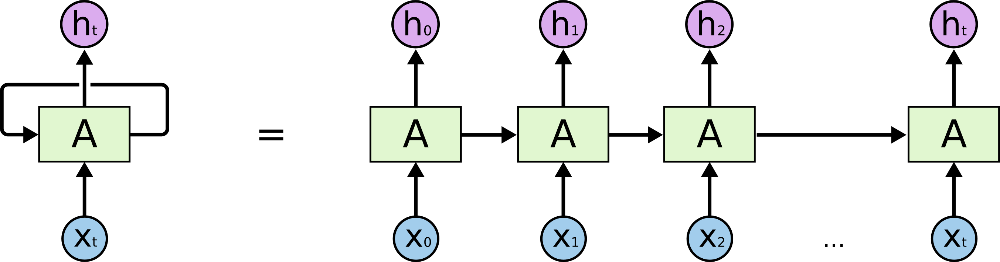

More information:

*  https://colah.github.io/posts/2015-08-Understanding-LSTMs/
*  https://towardsdatascience.com/lstm-time-series-forecasting-predicting-stock-prices-using-an-lstm-model-6223e9644a2f
* https://towardsdatascience.com/recurrent-neural-network-to-predict-multivariate-commodity-prices-8a8202afd853


#### Importing libraries from TensorFlow



In [31]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import LSTM
from tensorflow.keras.optimizers import Adam 

plt.rcParams['figure.figsize'] = [8, 6]
plt.rcParams['figure.dpi'] = 100

#### Preparing Data

We are predicting the next day stock price by considering only the previous day market information. The data input format for LSTM is different compared to our previous models.

Models expect data in below format.

```[samples, timesteps, features]```

* Samples : Number of samples available in the dataset
* Timesteps : How many previous observations used to predict the future value
* Features : Number of features used in the dataset

The function named *create_dataset* will simplify the process of converting our existing datasets to expected format.

***Note: Since we have previously shifted the close stock price backward, we are undoing that behaviour by forward shifting the stock price to match with the current day price. The create_dateset function will do the shift based on the number of timesteps.***

More information: https://machinelearningmastery.com/convert-time-series-supervised-learning-problem-python/

In [32]:
def create_dataset(X, y, time_steps=1):
        Xs, ys = [], []
        for i in range(len(X) - time_steps):
            v = X[i:(i + time_steps)]
            Xs.append(v)
            ys.append(y[i + time_steps])
        return np.array(Xs), np.array(ys)

In [33]:
train_df_lstm = train_df.copy()
#Undo the of shifting the stock price by one day. 
#This added because create_dataset function will do the shifting
train_df_lstm['Close'] = train_df_lstm['Close'].shift(1)
train_df_lstm = train_df_lstm[1:]
y_train_lstm = train_df_lstm[['Close']]

test_df_lstm = test_df.copy()
test_df_lstm['Close'] = test_df_lstm['Close'].shift(1)
test_df_lstm = test_df_lstm[1:]
y_test_lstm  = test_df_lstm[['Close']]

valid_df_lstm = valid_df.copy()
valid_df_lstm['Close'] = valid_df_lstm['Close'].shift(1)
valid_df_lstm = valid_df_lstm[1:]
y_valid_lstm  = valid_df_lstm[['Close']]

#### Feature normalization

Input data to the ANN networks should be normalized to speed up the learning and achieve faster convergence of the network.

Existing training, validation and testing datasets are used to train the LSTM model.




In [34]:
X_train_lstm = train_df_lstm.drop(['Close'], 1)
X_test_lstm = test_df_lstm.drop(['Close'], 1)
X_valid_lstm = valid_df_lstm.drop(['Close'], 1)

In [35]:
scaler = MinMaxScaler(feature_range=(0, 1))
scaler = scaler.fit(X_train_lstm)
scaler_target = MinMaxScaler(feature_range=(0, 1))
scaler_target = scaler_target.fit(y_train_lstm)

X_train_lstm = scaler.transform(X_train_lstm)
y_train_lstm = scaler_target.transform(y_train_lstm)

X_test_lstm = scaler.transform(X_test_lstm)
y_test_lstm = scaler_target.transform(y_test_lstm)

X_valid_lstm = scaler.transform(X_valid_lstm)
y_valid_lstm = scaler_target.transform(y_valid_lstm)

x_train_set, y_train_set = create_dataset(X_train_lstm, y_train_lstm, 1)
x_valid_set, y_valid_set = create_dataset(X_valid_lstm, y_valid_lstm, 1)
x_test_set, y_test_set = create_dataset(X_test_lstm, y_test_lstm, 1)

#### LSTM Architecture

We use a two layer LSTM network with set of feed forward layers. Dropout layers are used to provide regularization which reduce the overfitting.

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 1, 60)             16560     
                                                                 
 lstm_1 (LSTM)               (None, 60)                29040     
                                                                 
 dropout (Dropout)           (None, 60)                0         
                                                                 
 dense (Dense)               (None, 30)                1830      
                                                                 
 dropout_1 (Dropout)         (None, 30)                0         
                                                                 
 dense_1 (Dense)             (None, 1)                 31        
                                                                 
Total params: 47,461
Trainable params: 47,461
Non-traina

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning:

The `lr` argument is deprecated, use `learning_rate` instead.



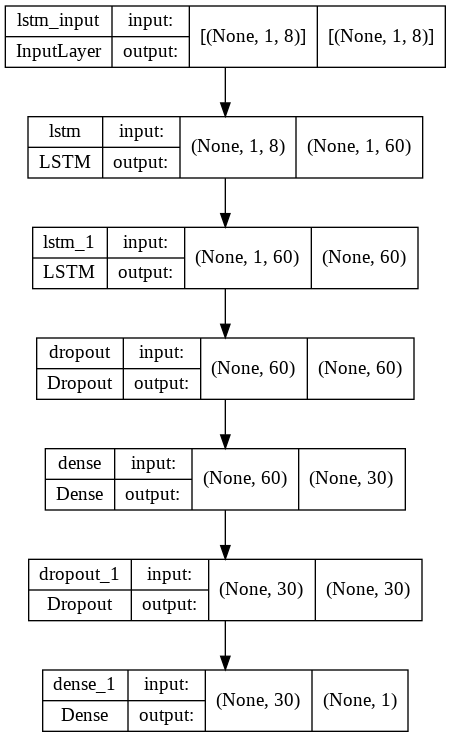

In [36]:
from tensorflow.keras.utils import plot_model

model_lstm = Sequential()
model_lstm.add(LSTM(60, return_sequences=True, input_shape=(x_train_set.shape[1], x_train_set.shape[2])))
model_lstm.add(LSTM(60))
model_lstm.add(Dropout(0.1))
model_lstm.add(Dense(30))
model_lstm.add(Dropout(0.1))
model_lstm.add(Dense(1))
model_lstm.compile(loss='mae', optimizer=Adam(lr=0.001))
model_lstm.summary()
plot_model(model_lstm, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

#### Train and Test

LSTM network uses mean absolute error loss function to optimize the target predictions. Batch size indicate how much data is present to the neural network at a given time. LSTM network optimizes the target predictions by presenting entire training dataset with batches over number of iterations.

Epoch 1/50
13/13 - 6s - loss: 0.3220 - val_loss: 0.3494 - 6s/epoch - 482ms/step
Epoch 2/50
13/13 - 0s - loss: 0.1514 - val_loss: 0.0330 - 107ms/epoch - 8ms/step
Epoch 3/50
13/13 - 0s - loss: 0.1212 - val_loss: 0.1250 - 114ms/epoch - 9ms/step
Epoch 4/50
13/13 - 0s - loss: 0.0757 - val_loss: 0.0374 - 128ms/epoch - 10ms/step
Epoch 5/50
13/13 - 0s - loss: 0.0532 - val_loss: 0.0449 - 105ms/epoch - 8ms/step
Epoch 6/50
13/13 - 0s - loss: 0.0485 - val_loss: 0.0301 - 115ms/epoch - 9ms/step
Epoch 7/50
13/13 - 0s - loss: 0.0451 - val_loss: 0.0281 - 124ms/epoch - 10ms/step
Epoch 8/50
13/13 - 0s - loss: 0.0437 - val_loss: 0.0341 - 111ms/epoch - 9ms/step
Epoch 9/50
13/13 - 0s - loss: 0.0422 - val_loss: 0.0320 - 119ms/epoch - 9ms/step
Epoch 10/50
13/13 - 0s - loss: 0.0391 - val_loss: 0.0320 - 113ms/epoch - 9ms/step
Epoch 11/50
13/13 - 0s - loss: 0.0410 - val_loss: 0.0270 - 101ms/epoch - 8ms/step
Epoch 12/50
13/13 - 0s - loss: 0.0381 - val_loss: 0.0260 - 103ms/epoch - 8ms/step
Epoch 13/50
13/13 - 0s -

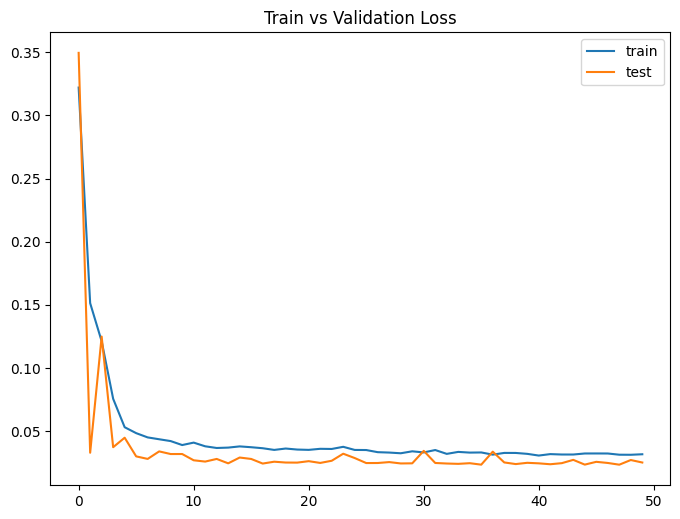

R2: 0.9580613501605498
MSE: 0.002447537281687324
MAE: 0.038582184523614144


In [37]:
history = model_lstm.fit(x_train_set, y_train_set, epochs=50, batch_size=128, validation_data=(x_valid_set, y_valid_set),
                        verbose=2, shuffle=True)

plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='test')
plt.legend()
plt.title("Train vs Validation Loss")
plt.show()

y_train_predict = model_lstm.predict(x_train_set)
y_train_predict_rescaled = scaler_target.inverse_transform(y_train_predict)
y_test_predict = model_lstm.predict(x_test_set)
y_test_predict_rescaled = scaler_target.inverse_transform(y_test_predict)

y_train_original_rescaled = scaler_target.inverse_transform(y_train_set)
y_test_original_rescaled = scaler_target.inverse_transform(y_test_set)


print("====================================================")
print("R2:", sm.r2_score(y_test_original_rescaled, y_test_predict_rescaled))
print("MSE:", sm.mean_squared_error(y_test_original_rescaled, y_test_predict_rescaled))
print("MAE:", sm.mean_absolute_error(y_test_original_rescaled, y_test_predict_rescaled))
print("====================================================")

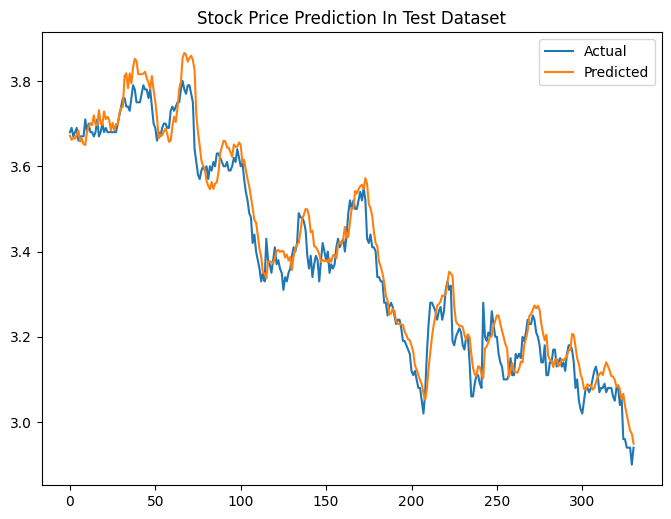

In [38]:
plt.plot(y_test_original_rescaled[:,0] ,label = "Actual")
plt.plot(y_test_predict_rescaled[:,0] ,label = "Predicted")
plt.legend()
plt.title("Stock Price Prediction In Test Dataset")
plt.show()